## Data preprocessing

In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt 
import os
import numpy as np
plt.rcParams['figure.dpi'] = 250

In [2]:
def equalize_this(image_file, with_plot=True, gray_scale=True):
    #image=cv2.cvtColor(image_file, cv2.COLOR_BGR2GRAY)
    image=image_file
    if not gray_scale:
        r_image, g_image, b_image = cv2.split(image)

        r_image_eq = cv2.equalizeHist(r_image)
        g_image_eq = cv2.equalizeHist(g_image)
        b_image_eq = cv2.equalizeHist(b_image)

        image_eq = cv2.merge((r_image_eq, g_image_eq, b_image_eq))
        cmap_val = None
    else:
        image_eq = cv2.equalizeHist(image)
        cmap_val = 'gray'

    if with_plot:
        fig = plt.figure(figsize=(10, 20))

        ax1 = fig.add_subplot(2, 2, 1)
        ax1.axis("off")
        ax1.title.set_text('Original')
        ax2 = fig.add_subplot(2, 2, 2)
        ax2.axis("off")
        ax2.title.set_text("Equalized")

        ax1.imshow(image, cmap=cmap_val)
        ax2.imshow(image_eq, cmap=cmap_val)
        #return True
    return image_eq

In [3]:
#bina= equalize_this(img,gray_scale=False)

In [4]:
def plotImg(img, process, cmap=None):
    plt.subplot(121), plt.imshow(img, cmap=cmap) 
    plt.subplot(122), plt.imshow(process, cmap=cmap) 
    plt.show()

In [5]:
def find(name, path):
    for root, dirs, files in os.walk(path):
        if name in files:
            return os.path.join(root, name)

In [6]:
def binarize(image_file, thresh_val=127, tipo=cv2.THRESH_BINARY ,with_plot=True, gray_scale=True):
    image= image_file
    if gray_scale is not True:
        image= cv2.cvtColor(image_file, cv2.COLOR_BGR2GRAY)
    th, image_b = cv2.threshold(src=image, thresh=thresh_val, maxval=255, type=tipo)
    #image_b= cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 221, 31)
    if with_plot:
        cmap_val = None if not gray_scale else 'gray'
        fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10, 20))
        
        ax1.axis("off")
        ax1.title.set_text('Original')
        
        ax2.axis("off")
        ax2.title.set_text("threshold")
        
        ax1.imshow(image, cmap=cmap_val)
        ax2.imshow(image_b, cmap=cmap_val)
        #return True
    return image_b

In [7]:
def binarize_lib(image_file, thresh_val=127, with_plot=True, gray_scale=True):
    image= image_file
    #normalizedImg = np.zeros(image_file.shape)
    #image= cv2.normalize(image_file, normalizedImg, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX)
    #gray= cv2.cvtColor(norm, cv2.COLOR_BGR2GRAY)
    if gray_scale is not True:
        image= cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    #th, image_b = cv2.threshold(src=image, thresh=thresh_val, maxval=255, type=cv2.THRESH_BINARY)
    image_b= cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 231, 51) #ADAPTIVE_THRESH_GAUSSIAN_C
    if with_plot:
        #cmap_val = 'gray' if not gray_scale else None
        fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(10, 20))
        
        ax1.axis("off")
        ax1.title.set_text('Original')
        
        ax2.axis("off")
        ax2.title.set_text("Adaptive")
        
        ax1.imshow(image, cmap='gray')
        ax2.imshow(image_b, cmap='gray')
        #return True
    return image_b

In [8]:
def filtering(image, filter_size=2):
    # Morph open to remove noise
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (filter_size,filter_size))
    opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel, iterations=1)

    # Find contours and remove small noise
    cnts = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    #print(cnts)
    for c in cnts:
        area = cv2.contourArea(c)
        if area < 40:
            cv2.drawContours(opening, [c], -1, 0, -1)

    # Invert and apply slight Gaussian blur
    return opening
#result = cv2.GaussianBlur(result, (3,3), 0)

In [9]:
from scipy.linalg import norm

def normalize(arr):
    rng = arr.max()-arr.min()
    amin = arr.min()
    return (arr-amin)*255/rng

def to_grayscale(arr):
    "If arr is a color image (3D array), convert it to grayscale (2D array)."
    if len(arr.shape) == 3:
        return np.average(arr, -1)  # average over the last axis (color channels)
    else:
        return arr
    
def compare_images(img1, img2):
    # normalize to compensate for exposure difference, this may be unnecessary
    # consider disabling it
    img1= to_grayscale(img1)
    img1 = normalize(img1)
    img2 = normalize(img2)
    # calculate the difference and its norms
    diff = img1 - img2  # elementwise for scipy arrays
    m_norm = np.sum(abs(diff))  # Manhattan norm
    z_norm = norm(diff.ravel(), 0)  # Zero norm
    eu_dis = cv2.norm(img1, img2)
    return (m_norm, eu_dis)

/home/mauricio/.local/lib/python3.8/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.0
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


/home/mauricio/Documents/Pytorch/kaggle-kuzushiji-2019/data/train_images1/200015779_00013_1.jpg
[199.64129466 188.79765429 173.71505107]
25.926243594271398
B/W


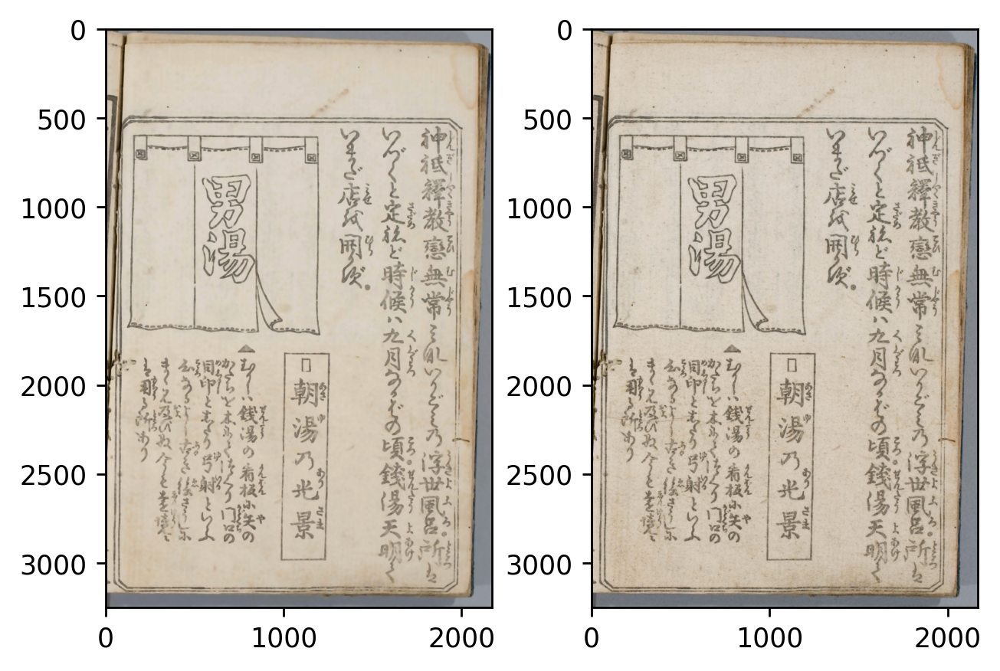

In [10]:
path='/home/mauricio/Documents/Pytorch/kaggle-kuzushiji-2019/data/'
folder= ['train_images1', 'test_images1'] 

file= '200015779_00013_1.jpg'
for loc in folder:
    imagen= find(file,path+loc)
    if imagen is not None:
        break
print(imagen)    
img_o = cv2.imread(os.path.join(path+loc,imagen))
img_o = cv2.cvtColor(img_o, cv2.COLOR_BGR2RGB)
# denoising of image saving it into dst image 
dst = cv2.fastNlMeansDenoisingColored(img_o, None, 10, 10, 7, 15) 
kernel = np.ones((4,4),np.uint8)
#erosion = cv2.erode(img,kernel,iterations = 1)
erosion = cv2.erode(dst,kernel,iterations = 1)
erosion2 = cv2.erode(img_o,kernel,iterations = 1)
# Plotting of source and destination image 

#get avg color
color_threshold= 35
avg_color_per_row = np.average(img_o, axis=0)
avg_color = np.average(avg_color_per_row, axis=0)
diff= avg_color[0]-avg_color[2]
print(avg_color)
print(diff)
if diff >=  color_threshold:
    print("color")
else:
    print("B/W")


plotImg(erosion,erosion2, cmap='gray')

In [11]:
#dilation = cv2.dilate(dst,kernel,iterations = 1)
normalizedImg = np.zeros(img_o.shape)
#gray= cv2.cvtColor(img_o, cv2.COLOR_BGR2GRAY)
norm= cv2.normalize(img_o, normalizedImg, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX)
#plotImg(img_o,norm, cmap='gray')

#background= cv2.bitwise_not(cv2.absdiff(erosion,dilation))
#print(background)

#bin2= binarize(erosion, thresh_val=115, tipo=cv2.THRESH_TOZERO) #THRESH_TOZERO #130
#bin_dil= binarize(dilation, thresh_val=120, tipo=cv2.THRESH_BINARY+cv2.THRESH_OTSU) #THRESH_TOZERO #130
#bin3= binarize_lib(bin2, gray_scale=True)


In [23]:
#plotImg(img_o,binn, cmap='gray')
h1= cv2.calcHist([img_o],[0],None,[255],[0,255])
h2= cv2.calcHist([norm],[0],None,[255],[0,255])
#plt.subplot(121), plt.hist(img_o.ravel(),256,[0,256])
#plt.subplot(122), plt.hist(norm.ravel(),256,[0,256])


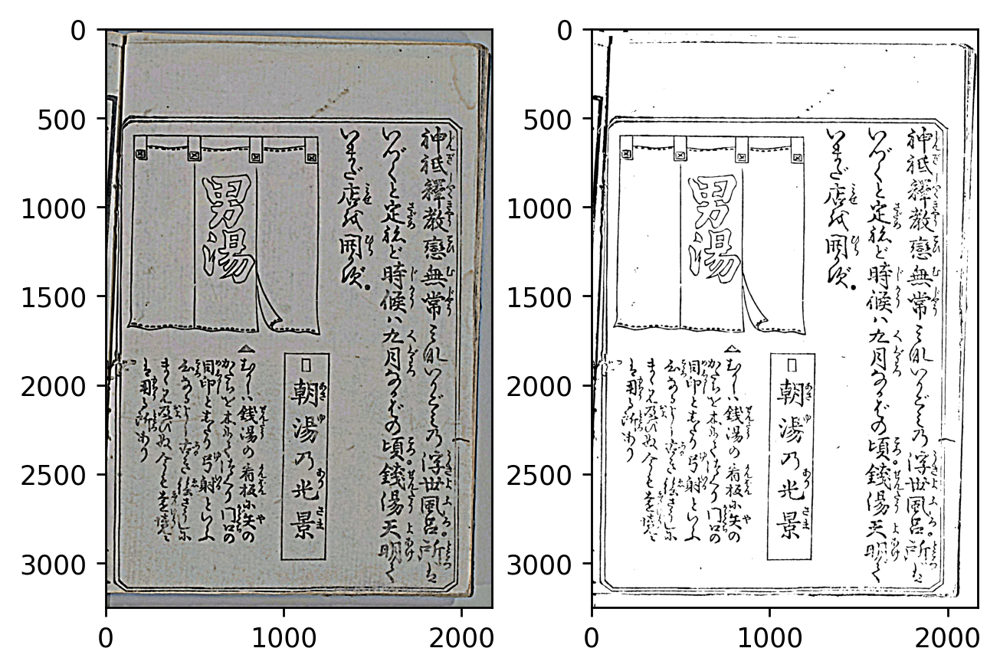

In [22]:

normalizedImg = np.zeros(img_o.shape)
norm= cv2.normalize(img_o, normalizedImg, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX)
dst = cv2.fastNlMeansDenoisingColored(norm, None, 10, 15, 7, 8) #  10, 15, 7, 15-> 8
# dst = cv2.fastNlMeansDenoisingColored(img_o, None, 10, 15, 7, 8) #  10, 15, 7, 15-> 8
kernel = np.ones((4,4),np.uint8)

ben_filter= cv2.addWeighted (dst,4, cv2.GaussianBlur(img_o, (0,0) , 10) ,-4 ,128)
erosion = cv2.erode(ben_filter,kernel,iterations = 1)
#plotImg(img_o,erosion)
#bin2= binarize(erosion, thresh_val=115, tipo=cv2.THRESH_TOZERO, gray_scale=False) #THRESH_TOZERO #130
#bin_dil= binarize(dilation, thresh_val=120, tipo=cv2.THRESH_BINARY+cv2.THRESH_OTSU) #THRESH_TOZERO #130
#bin3= binarize(erosion, gray_scale=False)
bin3= binarize_lib(erosion, gray_scale=False,with_plot=False)  
bin3= cv2.dilate(bin3,kernel,iterations = 1)
plotImg(erosion,bin3, cmap='gray')

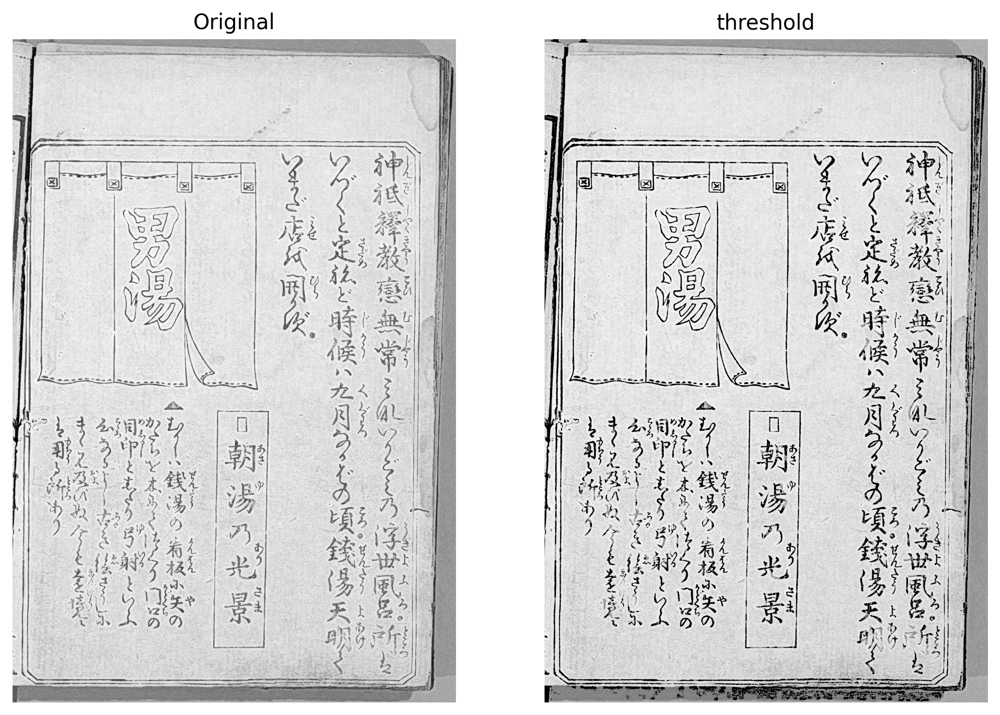

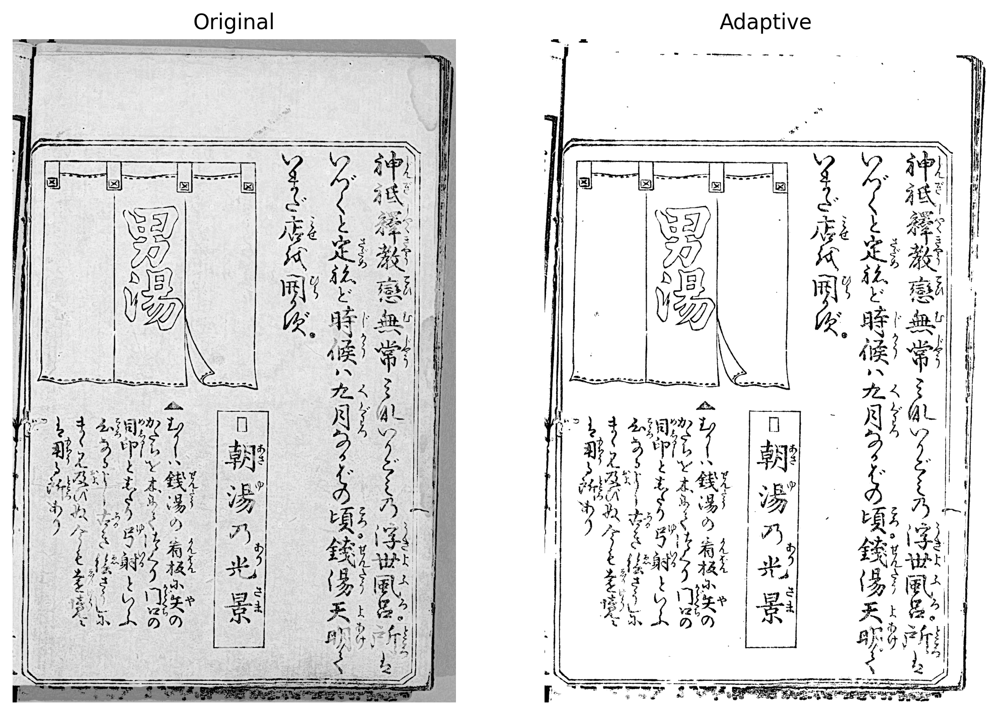

In [28]:
from skimage.filters.rank import enhance_contrast
from skimage.morphology import disk, ball

normalizedImg = np.zeros(img_o.shape)
norm= cv2.normalize(img_o, normalizedImg, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX)
gray= cv2.cvtColor(norm, cv2.COLOR_BGR2GRAY)
#dst = cv2.fastNlMeansDenoisingColored(enh, None, 10, 15, 7, 8) #  10, 15, 7, 15-> 8
#gray= cv2.cvtColor(img_o, cv2.COLOR_BGR2GRAY)
enh = enhance_contrast(gray, disk(10))
#kernel = np.ones((4,4),np.uint8)
#erosion = cv2.erode(enh,kernel,iterations = 1)
bin22= binarize(enh, thresh_val=115, tipo=cv2.THRESH_TOZERO) #THRESH_TOZERO #130
#bin_dil= binarize(dilation, thresh_val=120, tipo=cv2.THRESH_BINARY+cv2.THRESH_OTSU) #THRESH_TOZERO #130
bin33= binarize_lib(bin22, gray_scale=True)

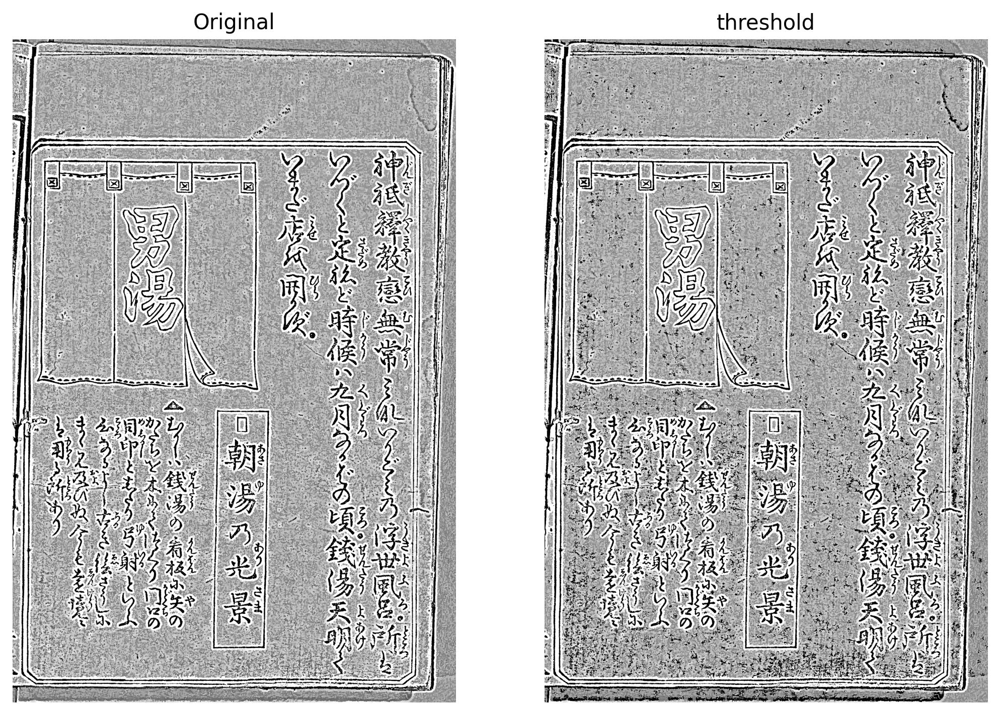

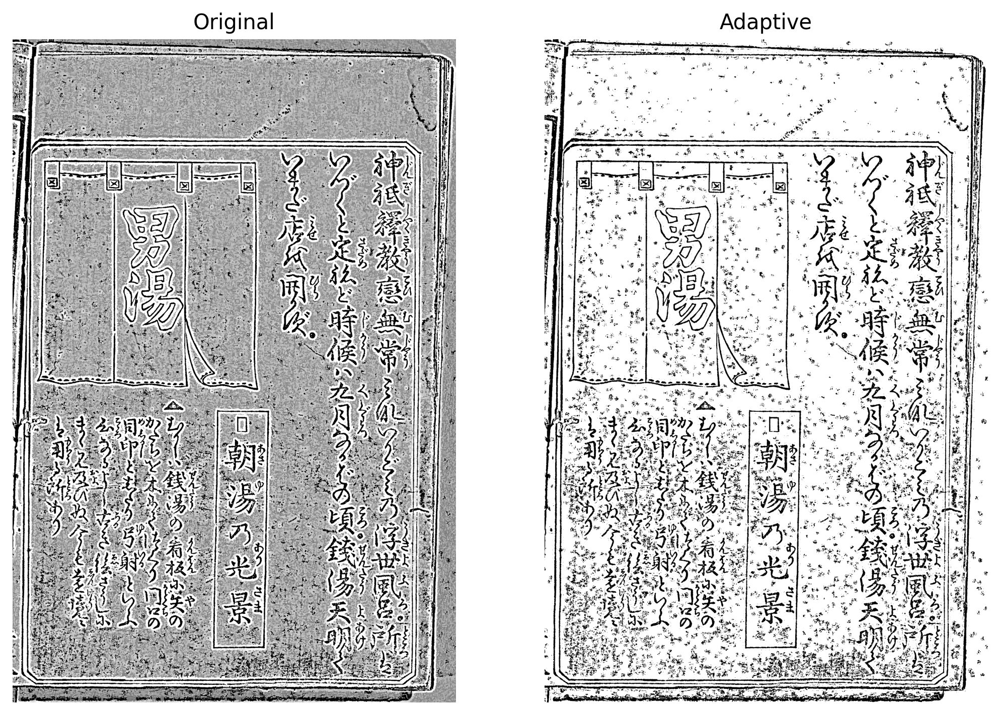

In [30]:
from skimage.filters.rank import enhance_contrast
from skimage.morphology import disk, ball


##No funciona
normalizedImg = np.zeros(img_o.shape)
norm= cv2.normalize(img_o, normalizedImg, alpha=0, beta=255,norm_type=cv2.NORM_MINMAX)
ben_filter= cv2.addWeighted (norm,4, cv2.GaussianBlur(img_o, (0,0) , 10) ,-4 ,128)
gray= cv2.cvtColor(ben_filter, cv2.COLOR_BGR2GRAY)
#dst = cv2.fastNlMeansDenoisingColored(enh, None, 10, 15, 7, 8) #  10, 15, 7, 15-> 8
#gray= cv2.cvtColor(img_o, cv2.COLOR_BGR2GRAY)

enh = enhance_contrast(gray, disk(10))
#kernel = np.ones((4,4),np.uint8)
#erosion = cv2.erode(enh,kernel,iterations = 1)
bin44= binarize(enh, thresh_val=115, tipo=cv2.THRESH_TOZERO) #THRESH_TOZERO #130
#bin_dil= binarize(dilation, thresh_val=120, tipo=cv2.THRESH_BINARY+cv2.THRESH_OTSU) #THRESH_TOZERO #130
bin55= binarize_lib(bin44, gray_scale=True)

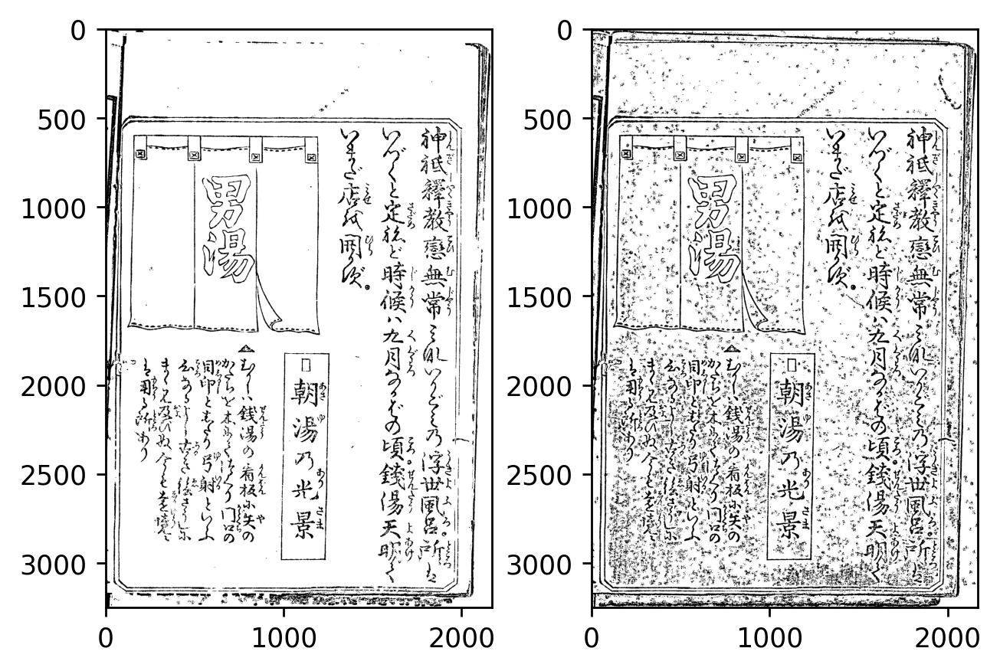

In [31]:
plotImg(bin33, bin55, cmap='gray')

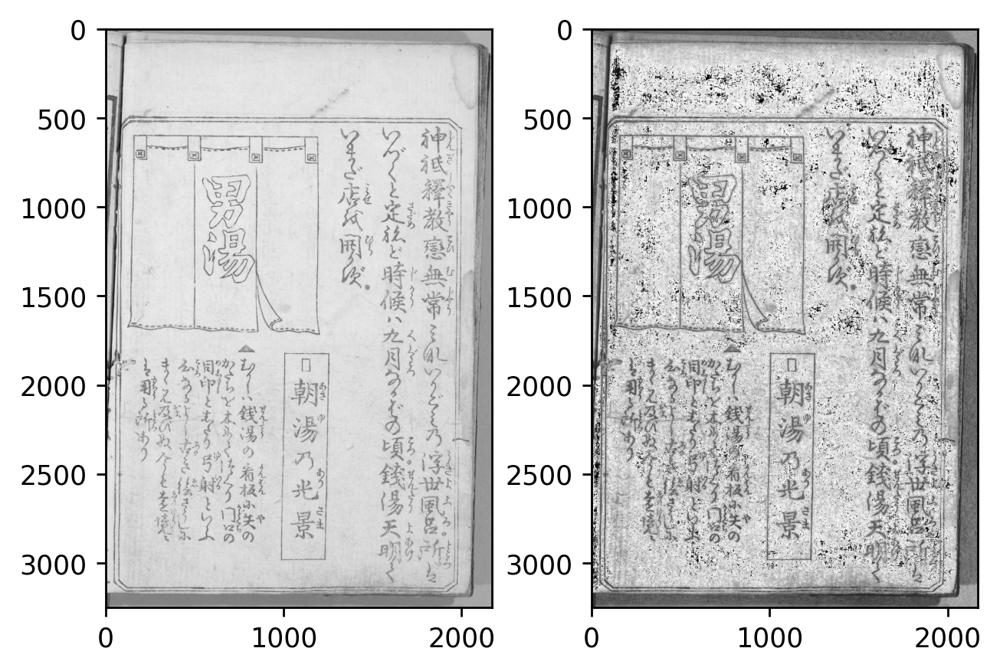

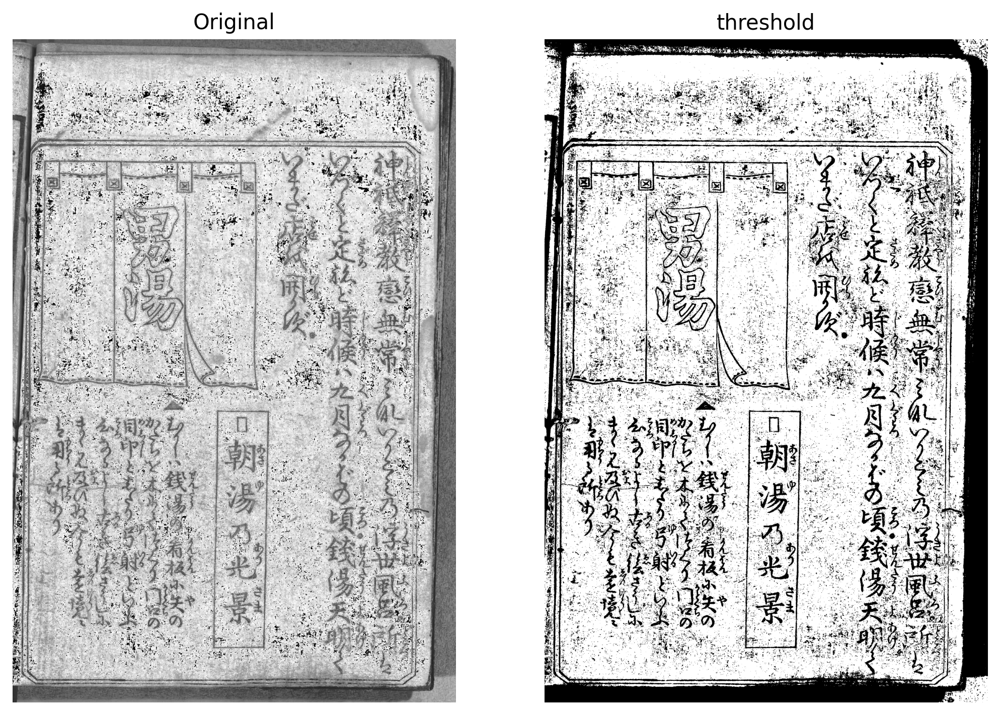

In [18]:
# def morphologic_filter(image, kernel):
#     gray= cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
#     enh = enhance_contrast(gray, disk(10))
#     erosion = cv2.erode(enh,kernel,iterations = 1)
#     bin22= binarize(erosion, thresh_val=115, tipo=cv2.THRESH_TOZERO) #THRESH_TOZERO #130
#     #bin_dil= binarize(dilation, thresh_val=120, tipo=cv2.THRESH_BINARY+cv2.THRESH_OTSU) #THRESH_TOZERO #130
#     bin33= binarize_lib(bin22, gray_scale=True)
#     return bin33
# bin33= morphologic_filter(img_o, kernel)

clahe = cv2.createCLAHE(clipLimit = 5)
final_img = clahe.apply(gray) + 30
plotImg(gray,final_img, cmap='gray')
bin4= binarize(final_img, thresh_val=127, tipo=cv2.THRESH_OTSU) #THRESH_TOZERO #130
#bin4= binarize_lib(gray,127)

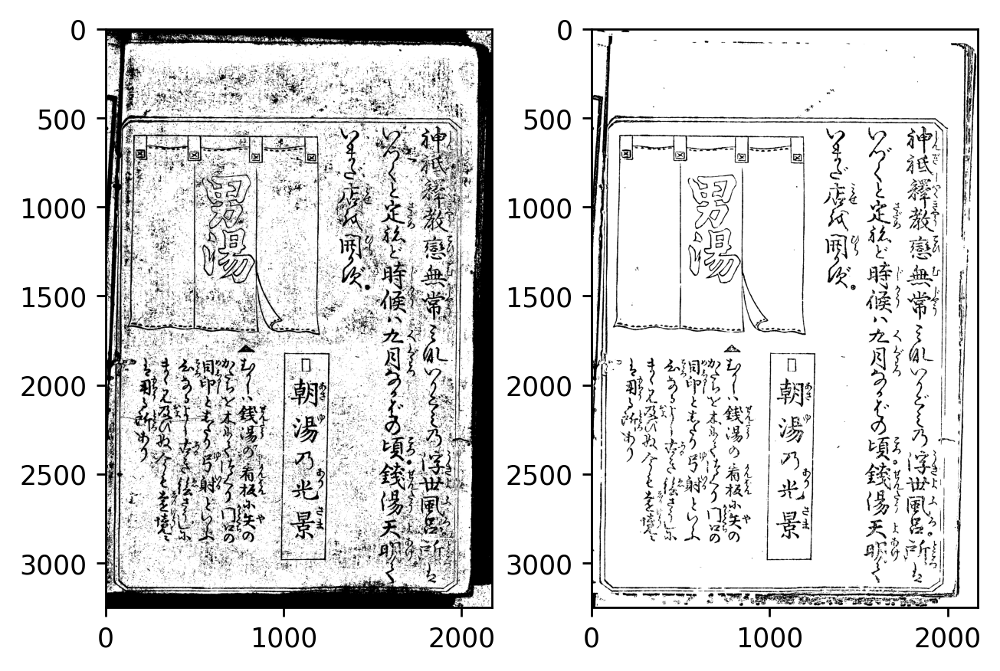

In [19]:
plotImg(bin4, bin33, cmap='gray')

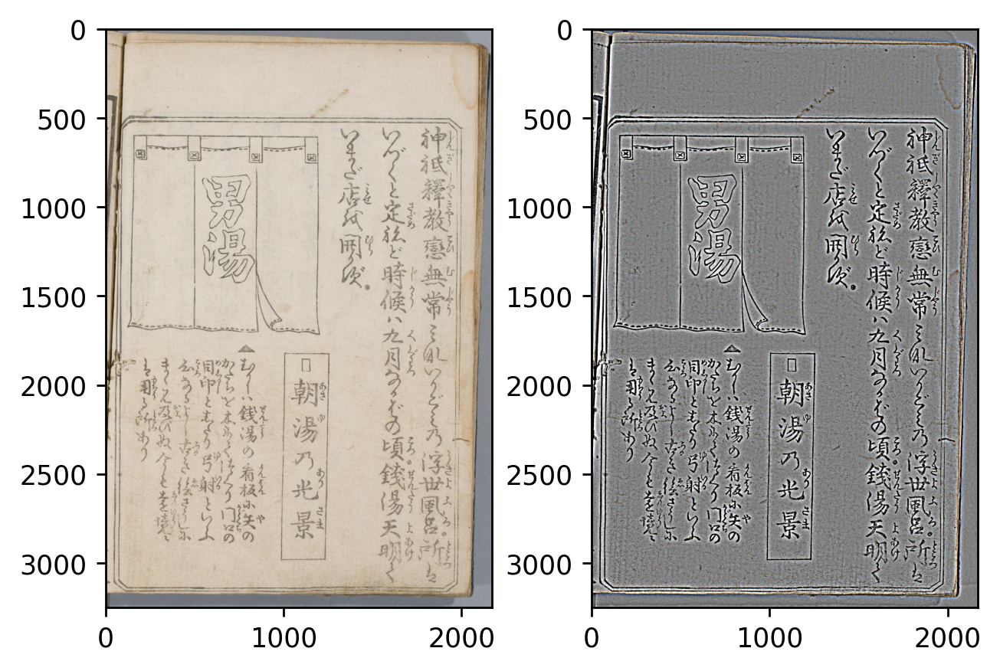

In [17]:
ben_filter= cv2.addWeighted (img_o,4, cv2.GaussianBlur(img_o, (0,0) , 10) ,-4 ,128)
plotImg(img_o,ben_filter)

In [ ]:

from math import log10, sqrt
import cv2
import numpy as np

"""
PSNR is most commonly used to estimate the efficiency of compressors, filters, etc. 
The larger the value of PSNR, the more efficient is a corresponding compression or filter method.
"""
def PSNR(original, compressed):
    original_gray= to_grayscale(original)
    mse = np.mean((original_gray - compressed) ** 2)
    #print(mse)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

print(PSNR(img_o,bin4))
print(PSNR(img_o,bin33))

In [ ]:
""" 
9.34318340223225
4.4872328831380495
"""

from sklearn.metrics import mean_squared_error
print(mean_squared_error(to_grayscale(img_o), bin3))

print(mean_squared_error(to_grayscale(img_o), bin33))

In [ ]:
n_m_adap, n_0 = compare_images(img_o, bin3)
print("Manhattan adap:", n_m_adap, "/ per pixel:", n_m_adap/img_o.size)
print("Eucli adap:", n_0, "/ per pixel:", n_0*1.0/img_o.size)
print("")
n_m_thres, n_0 = compare_images(img_o, bin33)
print("Manhattan thres:", n_m_thres, "/ per pixel:", n_m_thres/img_o.size)
print("eucli thres:", n_0, "/ per pixel:", n_0*1.0/img_o.size)

#compare_images(erosion, binn)

In [ ]:
print((erosion.shape))
print(((binn.shape)))

In [ ]:
#save?
# cv2.imwrite('t_adaptive.jpg',binn)
# cv2.imwrite('t_threshold.jpg',bin2) 
# cv2.imwrite('t_thres_adp.jpg', bin3)
#cv2.imwrite('denoised2.jpg',binn)

In [ ]:
imagen

In [ ]:
##Just normal filtering without addin extra adapting threshold

# Load image, convert to HSV, color threshold to get mask
image = cv2.imread(imagen)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

# Morph open to remove noise
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))
opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=1)

# Find contours and remove small noise
cnts = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
#print(cnts)
for c in cnts:
    area = cv2.contourArea(c)
    if area < 20:
        cv2.drawContours(opening, [c], -1, 0, -1)

# Invert and apply slight Gaussian blur
result = 255 - opening
#result = cv2.GaussianBlur(result, (3,3), 0)

plotImg(img_o,result, cmap='gray')
#a= binarize(img_o, thresh_val=130, tipo=cv2.THRESH_OTSU) #THRESH_TOZERO #130

In [ ]:
cv2.imwrite('n_modo_3.jpg', result)

In [ ]:


#plotImg(bin3,result, cmap='gray')

In [ ]:
cv2.imwrite('n_modo_4.jpg', result)

In [ ]:
from skimage.filters import try_all_threshold
from skimage import data

img_r= cv2.cvtColor(img_o, cv2.COLOR_BGR2GRAY)

fig, ax = try_all_threshold(img_r, figsize=(5, 4), verbose=False)
plt.show()

In [ ]:
from skimage.filters.rank import autolevel
from skimage.morphology import disk, ball
from skimage.filters import threshold_mean

auto = autolevel(img_r, disk(60))
thresh = threshold_mean(auto)
binary = auto > thresh
plotImg(img_r, auto, cmap='gray')


In [ ]:
from skimage.filters.rank import enhance_contrast
enh = enhance_contrast(img_r, disk(10))
thresh = threshold_mean(enh)
binary = enh > thresh
plotImg(img_r, enh, cmap='gray')

In [ ]:
from skimage.filters.rank import enhance_contrast_percentile
penh = enhance_contrast_percentile(img_r, disk(5), p0=.1, p1=.9)
plotImg(enh, penh, cmap='gray')

### Crear training, testing dataset randomly from train.csv


In [1]:
import pandas as pd
path='/home/mauricio/Documents/Pytorch/kaggle-kuzushiji-2019/data/'
folder= ['train_images1', 'test_images1'] 

In [3]:
df= pd.read_csv(path+'train1.csv')
print(df.shape)
# print(df.head())
# new_df= df.sample(frac=0.083)
# print(new_df.shape)
test= df.sample(frac=.2)
print(test.shape)
train= df[~df['image_id'].isin(test['image_id'])] #new_df[~new_df['image_id'].isin(test['image_id'])]
print(train.shape)
# save???
#train.to_csv('new_train.csv',index=False)
#test.to_csv('new_test.csv', index=False)

(3605, 2)
(721, 2)
(2884, 2)


In [8]:
#create imgs datasets folders
import cv2
def create_data_folder(origin, output, just_test=True):
    # ruta de original dataset: path+'train_images1/'+list+'.jpg'
    train= pd.read_csv('train.csv') #new_train.csv
    test= pd.read_csv('sample_submission.csv') #new_test.csv
    data=[test]
    if not just_test:
        data= [train, test]
    #n=0
    for d in data: 
        for list in d['image_id']:
            image= cv2.imread(path+'train_images1/'+list+'.jpg') #path+'train_images1/'+list+'.jpg', 'origin+list+'.jpg'
            #a='train' if n==0 else 'test'
            cv2.imwrite(output+list+'.jpg',image)
        #n+=1

In [9]:
#create new dataset???
create_data_folder('test/','test/')